In [25]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from PIL import Image

In [26]:
class Particle:
    """Define physics of elastic collision."""
    
    def __init__(self, mass, radius, position, velocity, element):
        """Initialize a Particle object
        
        mass the mass of particle
        radius the radius of particle
        position the position vector of particle
        velocity the velocity vector of particle
        """
        self.mass = mass
        self.radius = radius
        self.element = element
        
        # last position and velocity
        self.position = np.array(position)
        self.velocity = np.array(velocity)
        
        # all position and velocities recorded during the simulation
        self.solpos = [np.copy(self.position)]
        self.solvel = [np.copy(self.velocity)]
        self.solvel_mag = [np.linalg.norm(np.copy(self.velocity))]
        
    def compute_step(self, step):
        """Compute position of next step."""
        self.position += step * self.velocity
        self.solpos.append(np.copy(self.position)) 
        self.solvel.append(np.copy(self.velocity)) 
        self.solvel_mag.append(np.linalg.norm(np.copy(self.velocity))) 
        
    
    def check_coll(self, particle):
        """Check if there is a collision with another particle."""
        
        r1, r2 = self.radius, particle.radius
        x1, x2 = self.position, particle.position
        di = x2-x1
        norm = np.linalg.norm(di)
        if norm-(r1+r2)*1.01 < 0:
            return True
        else:
            return False

    
    def compute_coll(self, particle, step):
        """Compute velocity after collision with another particle."""
        m1, m2 = self.mass, particle.mass
        r1, r2 = self.radius, particle.radius
        v1, v2 = self.velocity, particle.velocity
        x1, x2 = self.position, particle.position
        di = x2-x1
        norm = np.linalg.norm(di)
        if norm-(r1+r2)*1.01 < step*abs(np.dot(v1-v2, di))/norm:
            self.velocity = v1 - 2. * m2/(m1+m2) * np.dot(v1-v2, di) / (np.linalg.norm(di)**2.) * di
            particle.velocity = v2 - 2. * m1/(m2+m1) * np.dot(v2-v1, (-di)) / (np.linalg.norm(di)**2.) * (-di)
            

    def compute_refl(self, step, size):
        """Compute velocity after hitting an edge.
        step the computation step
        size the medium size
        """
        r, v, x = self.radius, self.velocity, self.position
        projx = step*abs(np.dot(v,np.array([1.,0.])))
        projy = step*abs(np.dot(v,np.array([0.,1.])))
        if abs(x[0])-r < projx or abs(size-x[0])-r < projx:
            self.velocity[0] *= -1
        if abs(x[1])-r < projy or abs(size-x[1])-r < projy:
            self.velocity[1] *= -1.


def solve_step(particle_list, step, size):
    """Solve a step for every particle."""
    
    # Detect edge-hitting and collision of every particle
    for i in range(len(particle_list)):
        particle_list[i].compute_refl(step,size)
        for j in range(i+1,len(particle_list)):
                particle_list[i].compute_coll(particle_list[j],step)    

                
    # Compute position of every particle  
    for particle in particle_list:
        particle.compute_step(step)

In [42]:
def init_list_random(N_list, radius, mass, element_list, boxsize):
    """Generate N Particle objects in a random way in a list."""
    particle_list = []

    for j in range(len(N_list)):
        N = N_list[j]
        element = element_list[j]
        for i in range(N):
            
            v_mag = np.random.rand(1)*50
            v_ang = np.random.rand(1)*2*np.pi
            v = np.append(v_mag*np.cos(v_ang), v_mag*np.sin(v_ang))
            
            collision = True
            while(collision == True):
                
                collision = False
                pos = radius + np.random.rand(2)*(boxsize-2*radius)
                
                newparticle = Particle(mass, radius, pos, v, element)
                
                for j in range(len(particle_list)):

                    collision = newparticle.check_coll( particle_list[j] )

                    if collision == True:
                        break

            particle_list.append(newparticle)

    return particle_list


particle_number = [200, 200]
element_list = ['red','blue']
boxsize = 200.0

# You need a larger tfin and stepnumber to get the equilibrium state. But the computation takes more time.
tfin = 5
dt = 0.01
stepnumber = int(tfin/dt)

particle_list = init_list_random(particle_number, 1.5, 1, element_list, boxsize)

# Compute simulation (It takes some time if stepnumber and particle_number are large)
for i in range(stepnumber):
    solve_step(particle_list, dt, boxsize)
    #print(i)

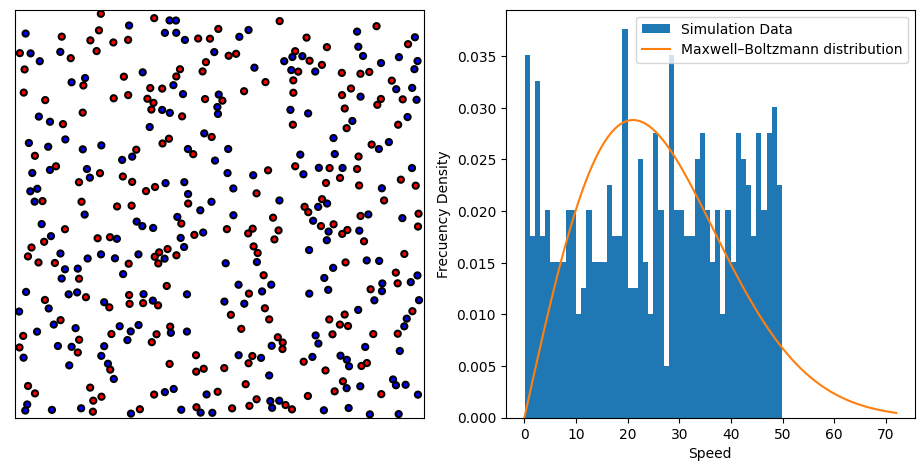

In [43]:
fig = plt.figure(figsize=(12, 6))
ax = fig.add_subplot(1,2,1)

hist = fig.add_subplot(1,2,2)

plt.subplots_adjust(bottom=0.2,left=0.15)

ax.axis('equal')
ax.axis([-1, 30, -1, 30])

ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
ax.set_xlim([0,boxsize])
ax.set_ylim([0,boxsize])

# Draw Particles as circles
circle = [None]*len(particle_list)
for i in range(len(particle_list)):
    circle[i] = plt.Circle((particle_list[i].solpos[0][0], particle_list[i].solpos[0][1]), particle_list[i].radius,
                           color = particle_list[i].element ,ec="black", lw=1.5, zorder=20)
    ax.add_patch(circle[i])

# Graph Particles speed histogram
vel_mod = [particle_list[i].solvel_mag[0] for i in range(len(particle_list))]
hist.hist(vel_mod, bins= 50, density = True, label = "Simulation Data")
hist.set_xlabel("Speed")
hist.set_ylabel("Frecuency Density")



# Compute 2d Boltzmann distribution

#total energy should be constant for any time index
def total_Energy(particle_list, index): 
    return sum([particle_list[i].mass / 2. * particle_list[i].solvel_mag[index]**2  for i in range(len(particle_list))])


E = total_Energy(particle_list, 0)
Average_E = E/len(particle_list) 
k = 1.38064852e-23
T = 2*Average_E/(2*k)
m = particle_list[0].mass
v = np.linspace(0,72,120)
fv = m*np.exp(-m*v**2/(2*T*k))/(2*np.pi*T*k)*2*np.pi*v
hist.plot(v,fv, label = "Maxwell–Boltzmann distribution") 
hist.legend(loc ="upper right")

MovieWriter imagemagick unavailable; using Pillow instead.


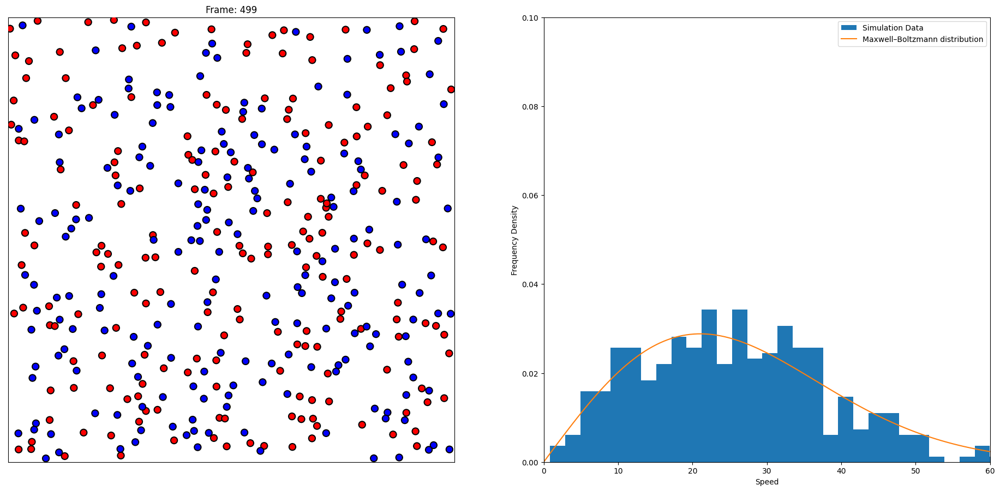

In [44]:
# Create the animation
fig = plt.figure(figsize=(24, 12))
ax = fig.add_subplot(1, 2, 1)
hist = fig.add_subplot(1, 2, 2)
plt.subplots_adjust(bottom=0.2,left=0.15)

def update_animation(frame):
    i = frame
    ax.clear()
    hist.clear()

    #for j in range(particle_number):
    #    circle[j].center = particle_list[j].solpos[i][0], particle_list[j].solpos[i][1]
    
    vel_mod = [particle_list[j].solvel_mag[i] for j in range(len(particle_list))]
    hist.hist(vel_mod, bins=40, density=True, label="Simulation Data")
    hist.set_xlabel("Speed")
    hist.set_ylabel("Frequency Density")
    
    E = total_Energy(particle_list, i)
    Average_E = E / len(particle_list)
    k = 1.38064852e-23
    T = 2 * Average_E / (2 * k)
    m = particle_list[0].mass
    v = np.linspace(0, 60, 120)
    fv = m * np.exp(-m * v ** 2 / (2 * T * k)) / (2 * np.pi * T * k) * 2 * np.pi * v
    hist.plot(v, fv, label="Maxwell–Boltzmann distribution")
    hist.legend(loc="upper right")
    hist.set_xlim([0,60.0])
    hist.set_ylim([0,0.1])


    # Create a frame for the animation
    #ax = fig.add_subplot(1, 2, 1)
    ax.axis('equal')
    ax.axis([-1, 30, -1, 30])
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    ax.set_xlim([0, boxsize])
    ax.set_ylim([0, boxsize])
    ax.set_title(f'Frame: {i}')

    # Lista para armazenar as caixas de anotações
    image_annotations = []

    # Crie as caixas de anotações com as imagens
    for j in range(len(particle_list)):
        circle[j].center = particle_list[j].solpos[i][0], particle_list[j].solpos[i][1]
        ax.add_patch(plt.Circle((particle_list[j].solpos[i][0], particle_list[j].solpos[i][1]), particle_list[j].radius, 
                                color = particle_list[j].element, ec="black", lw=1.5, zorder=20))

    return [circle]


FPS = int(1/dt)
intervalo = int(1000*dt)
animation = FuncAnimation(fig, update_animation, frames=stepnumber, interval=intervalo, repeat=True)

# Save the animation as a GIF
gif_nome = 'Gas_Ideal.gif'
animation.save(gif_nome, writer='imagemagick', fps=FPS)
plt.show()

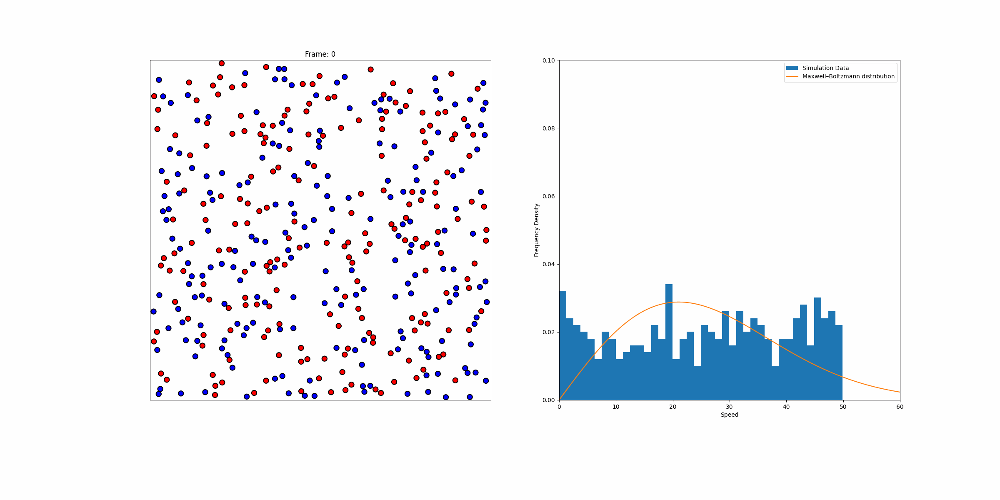

In [45]:
from IPython.display import display, Image

# Exibe o GIF diretamente na célula
display(Image(filename=gif_nome))

In [46]:
T

3.208467673903574e+25